In [1]:
import pandas as pd
import numpy as np
import multiprocessing
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
warnings.simplefilter('ignore')
sns.set()
%matplotlib inline

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [2]:
train_identity = pd.read_csv('train_identity.csv')
train_transaction = pd.read_csv('train_transaction.csv')
test_identity = pd.read_csv('test_identity.csv')
test_transaction = pd.read_csv('test_transaction.csv')

train = pd.merge(train_transaction, train_identity, on='TransactionID', how='left')
test = pd.merge(test_transaction, test_identity, on='TransactionID', how='left')

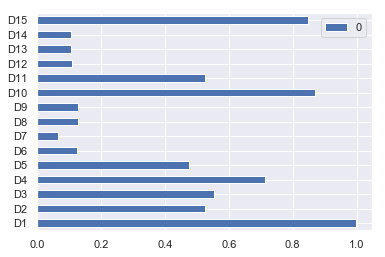

In [18]:
t1 = train[['D{}'.format(i) for i in range(1,16)]].notnull().sum().to_frame()/train.shape[0]
t1.plot(kind='barh')

In [19]:
def plot_index_vs_value(feature):
    """
    Plot some information about a numerical feature for both train and test set.
    Args:
        feature (str): name of the column in DataFrame
    """
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(32, 32))
    sns.kdeplot(train[feature], ax=axes[0][0], label='Train');
    sns.kdeplot(test[feature], ax=axes[0][0], label='Test');

    sns.kdeplot(train[train['isFraud']==0][feature], ax=axes[0][1], label='isFraud 0')
    sns.kdeplot(train[train['isFraud']==1][feature], ax=axes[0][1], label='isFraud 1')

    test[feature].index += len(train)
    axes[1][0].plot(train[feature], '.', color='blue',label='Train');
    axes[1][0].plot(test[feature], '.', color='black',label='Test');
    axes[1][0].set_xlabel('row index');
    axes[1][0].legend()
    test[feature].index -= len(train)

    axes[1][1].plot(train[train['isFraud']==0][feature], '.', color='green',label='isFraud 0');
    axes[1][1].plot(train[train['isFraud']==1][feature], '.', color='red', label='isFraud 1');
    axes[1][1].set_xlabel('row index');
    axes[1][1].legend()

    fig.suptitle(feature, fontsize=18);
    axes[0][0].set_title('Train/Test KDE distribution');
    axes[0][1].set_title('Target value KDE distribution');
    axes[1][0].set_title('Index versus value: Train/Test distribution');
    axes[1][1].set_title('Index versus value: Target distribution');

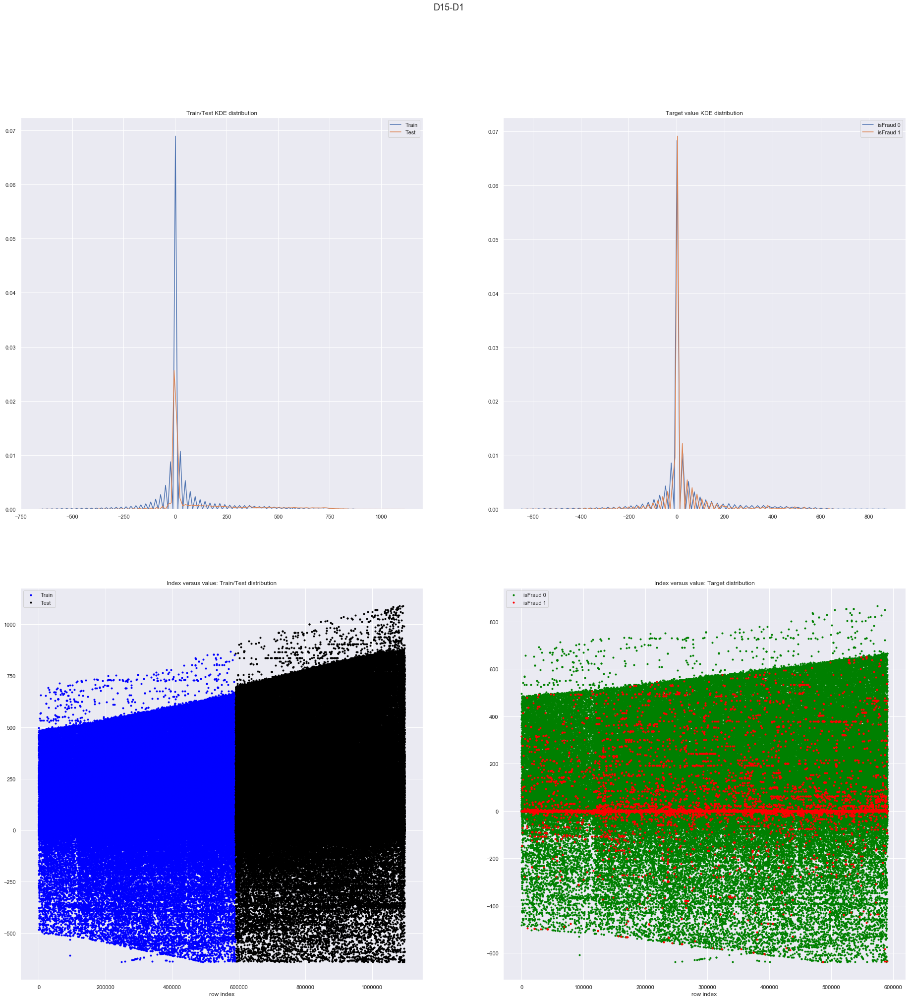

In [20]:
col1,col2 = 'D15','D1'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

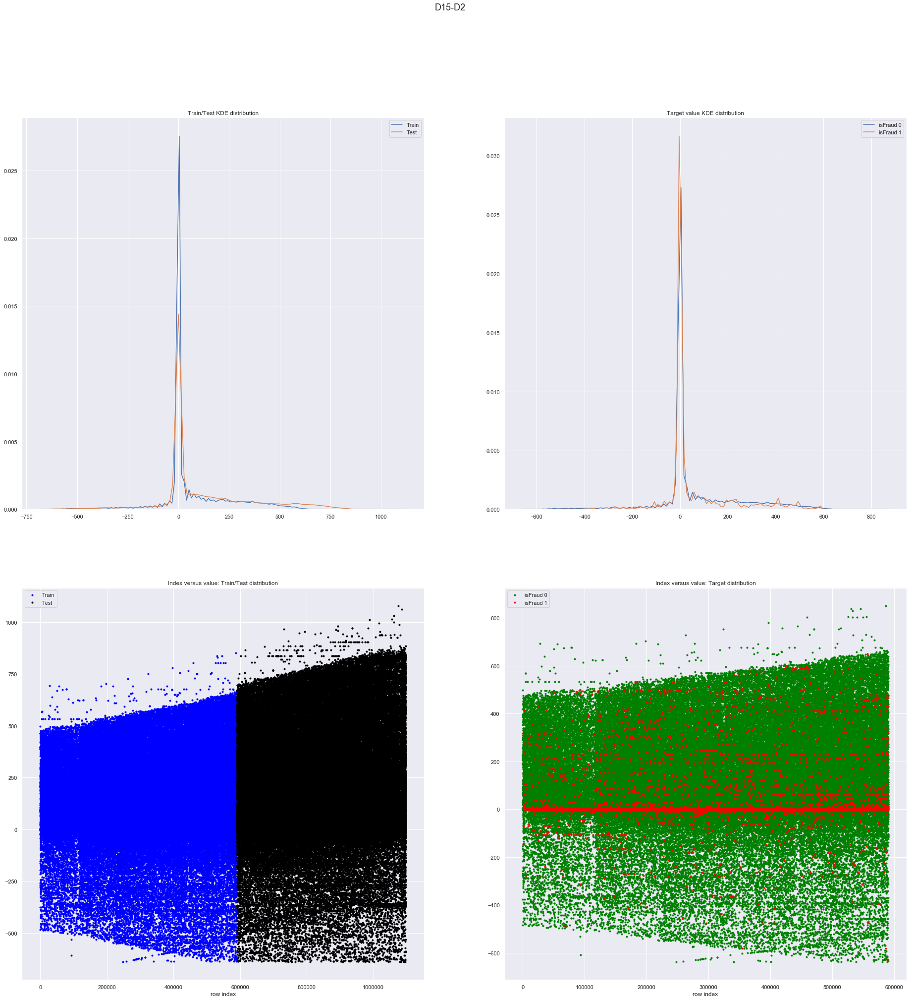

In [21]:
col1,col2 = 'D15','D2'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

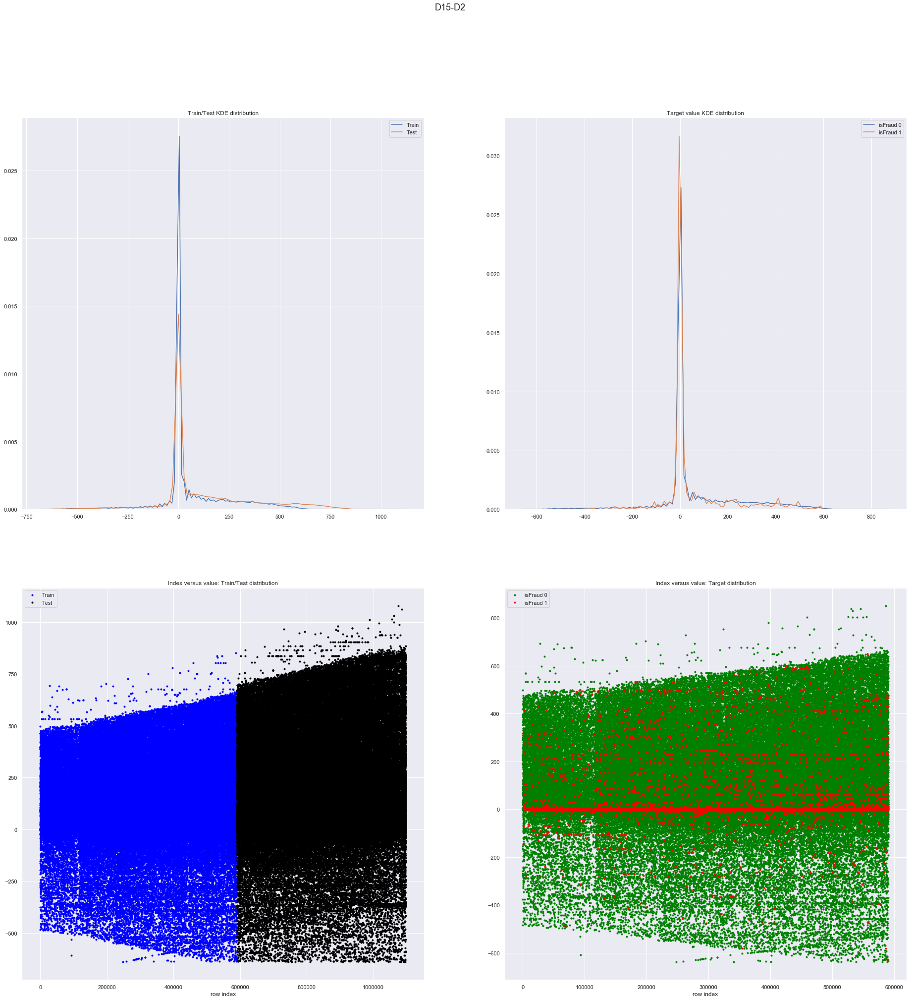

In [22]:
col1,col2 = 'D15','D2'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

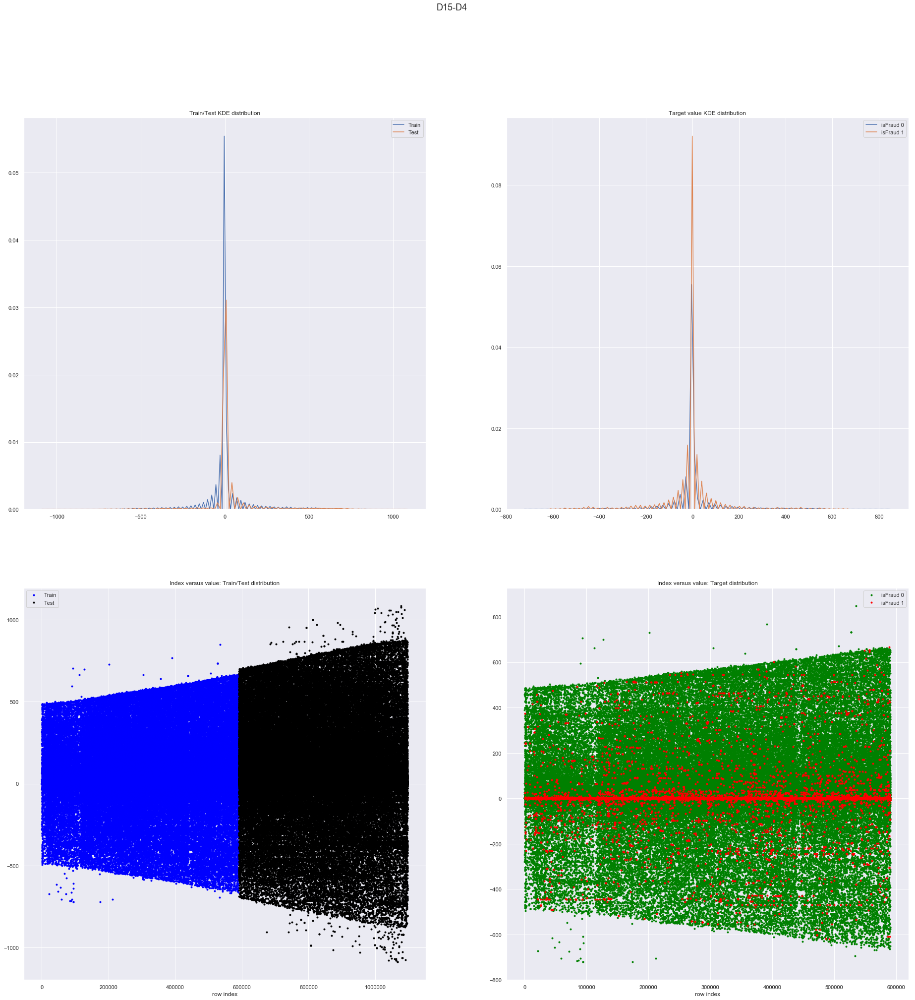

In [23]:
col1,col2 = 'D15','D4'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

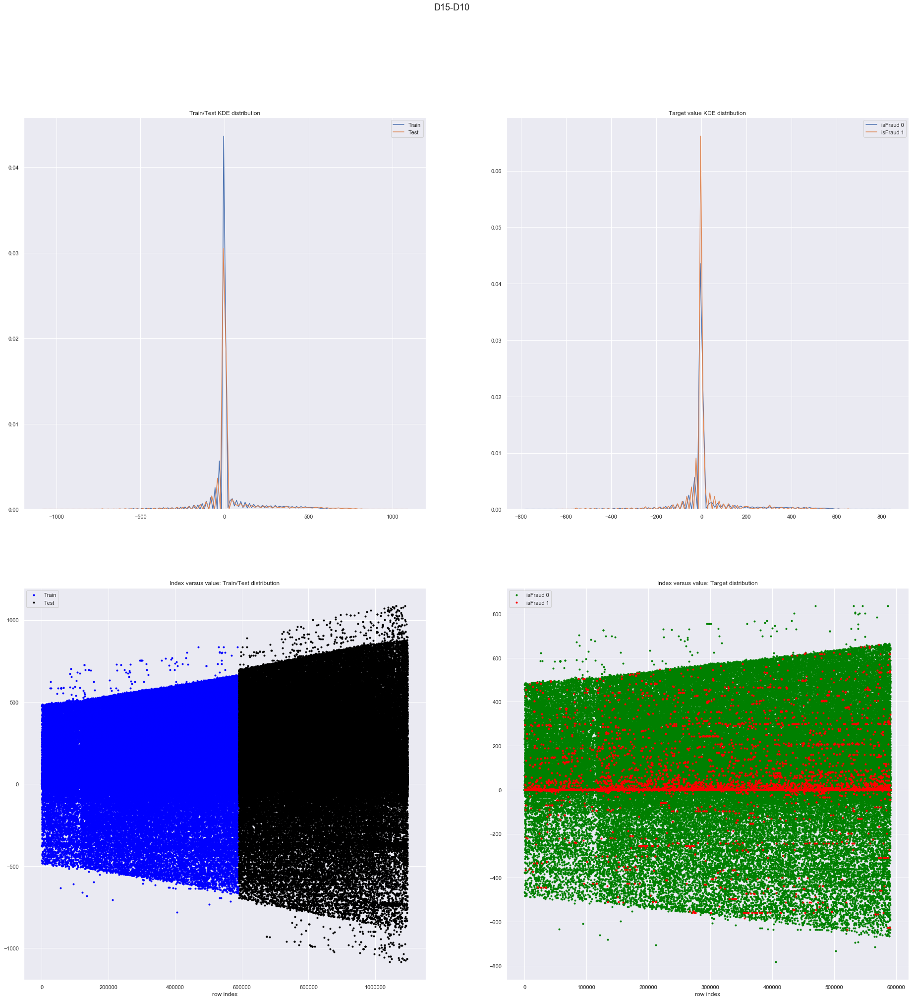

In [24]:
col1,col2 = 'D15','D10'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

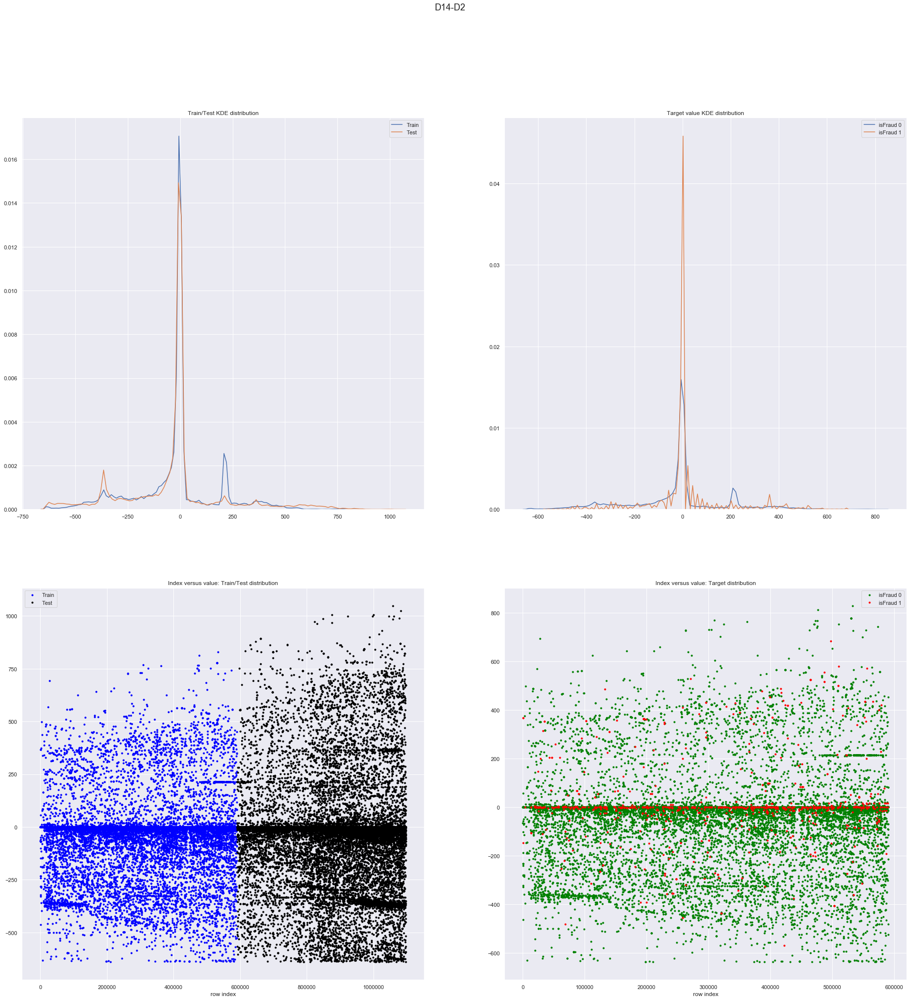

In [25]:
col1,col2 = 'D14','D2'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

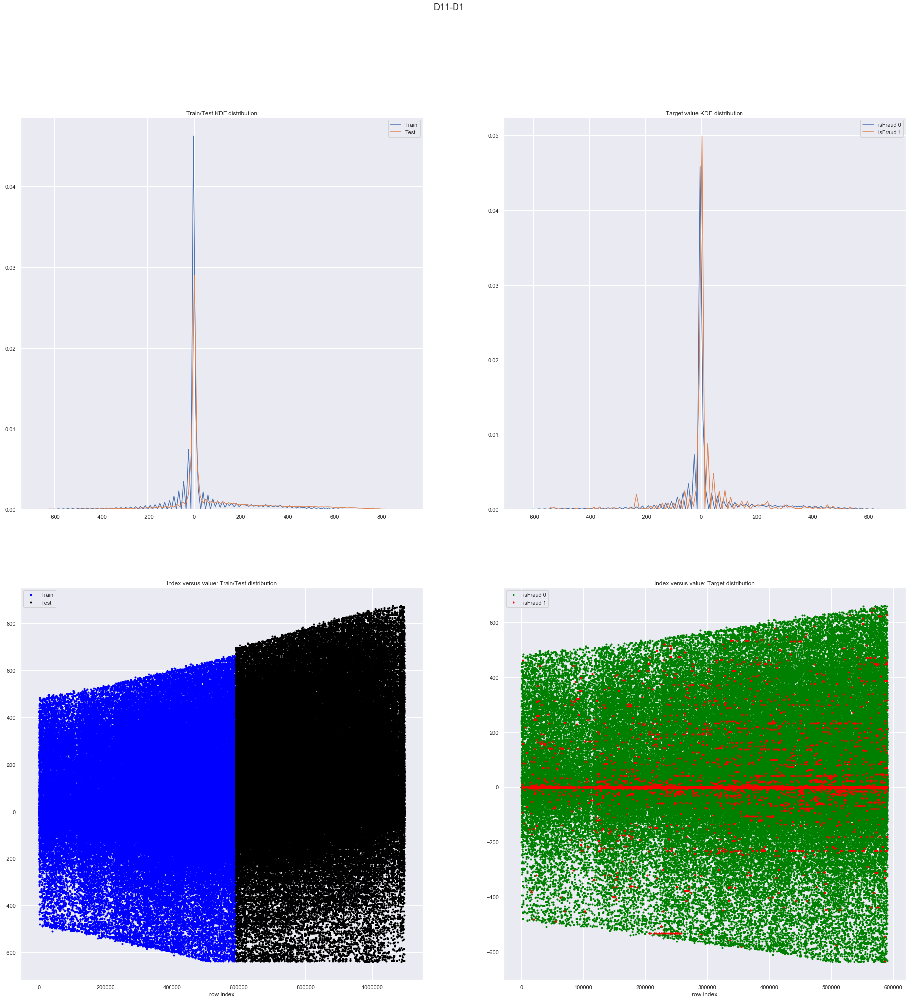

In [26]:
col1,col2 = 'D11','D1'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

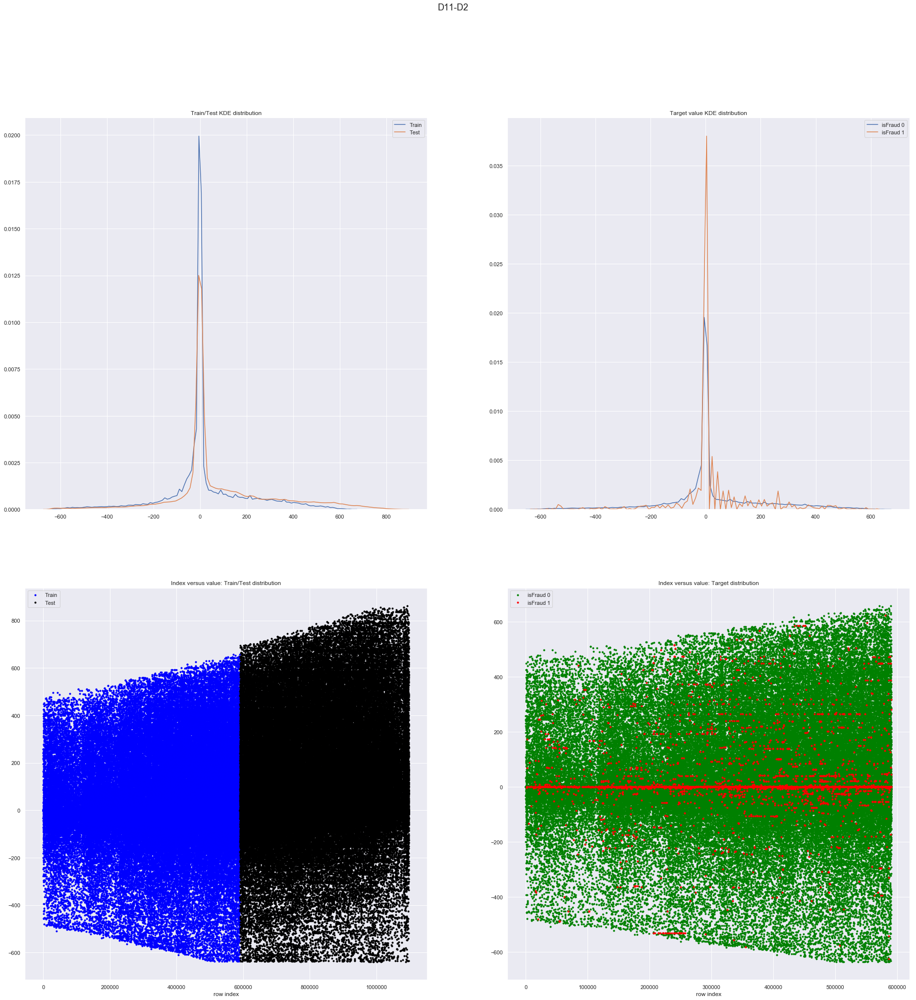

In [27]:
col1,col2 = 'D11','D2'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

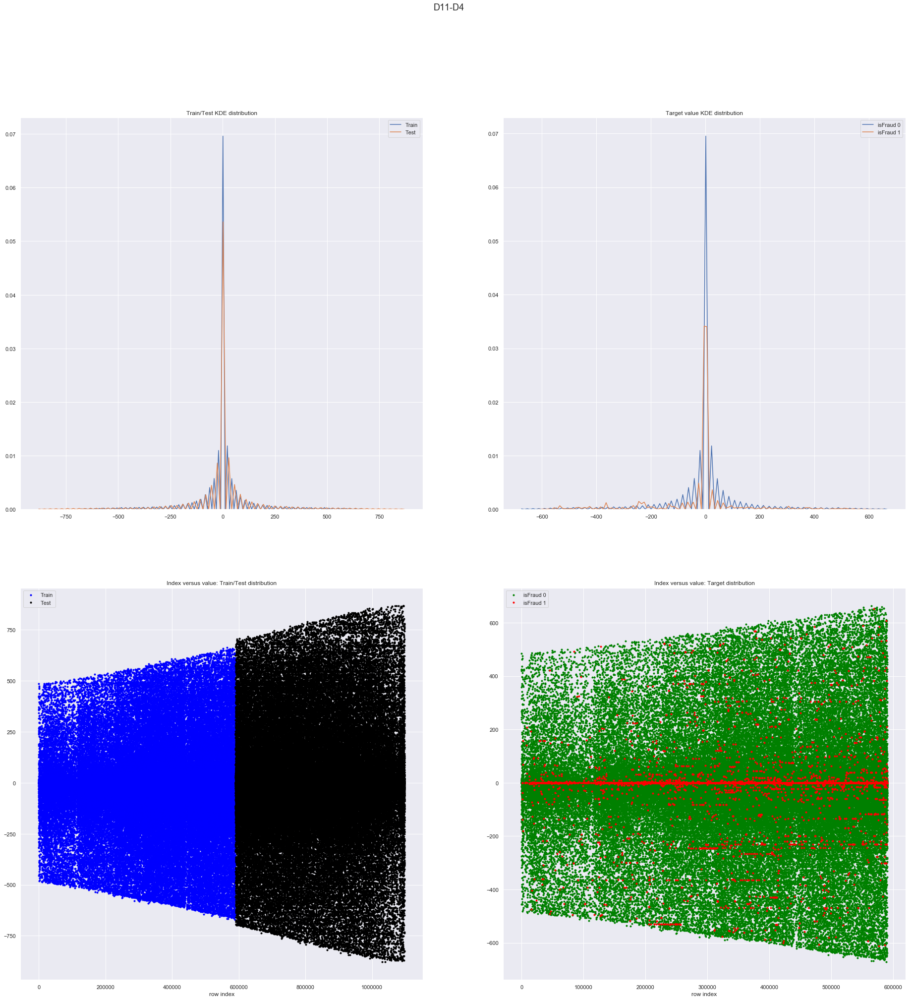

In [28]:
col1,col2 = 'D11','D4'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

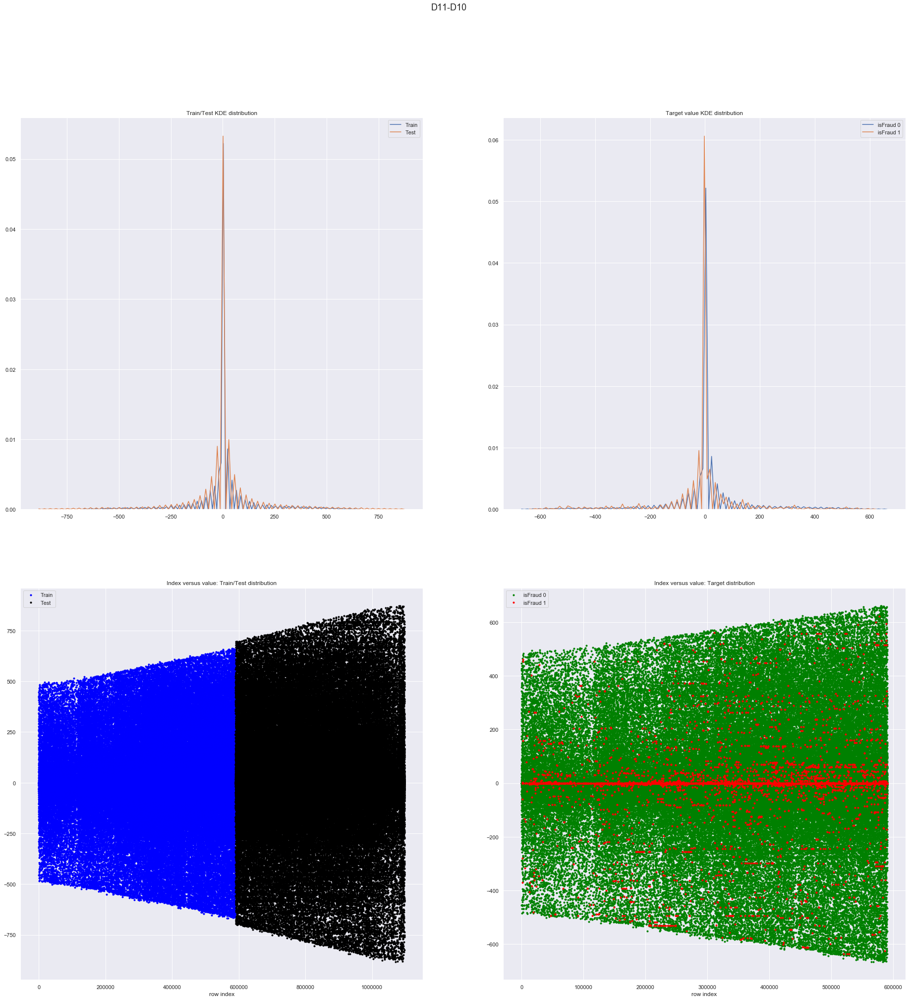

In [29]:
col1,col2 = 'D11','D10'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

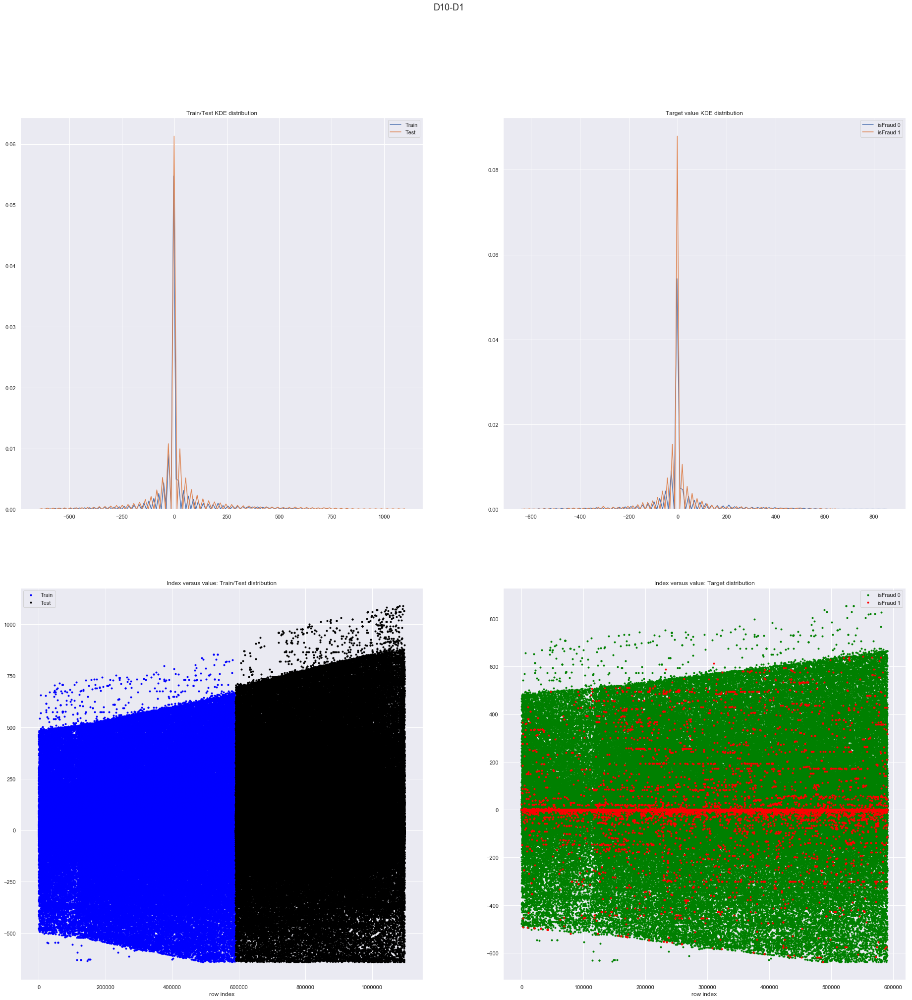

In [30]:
col1,col2 = 'D10','D1'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

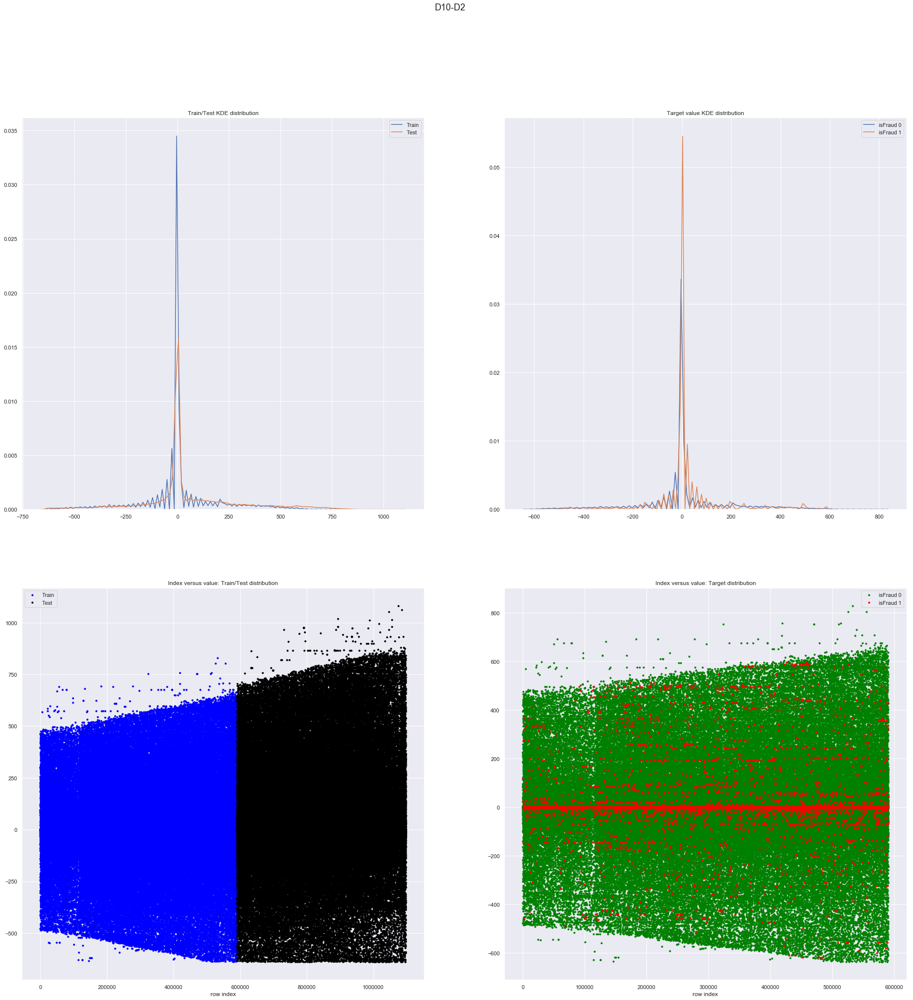

In [31]:
col1,col2 = 'D10','D2'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

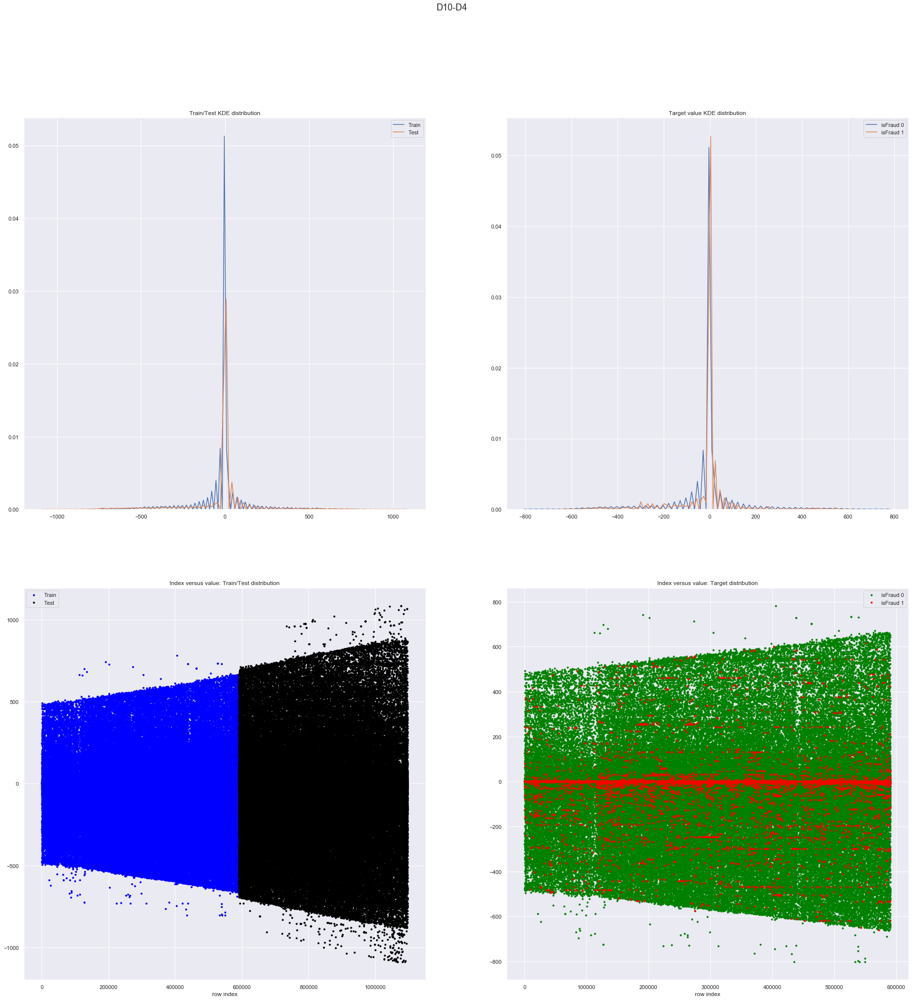

In [32]:
col1,col2 = 'D10','D4'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

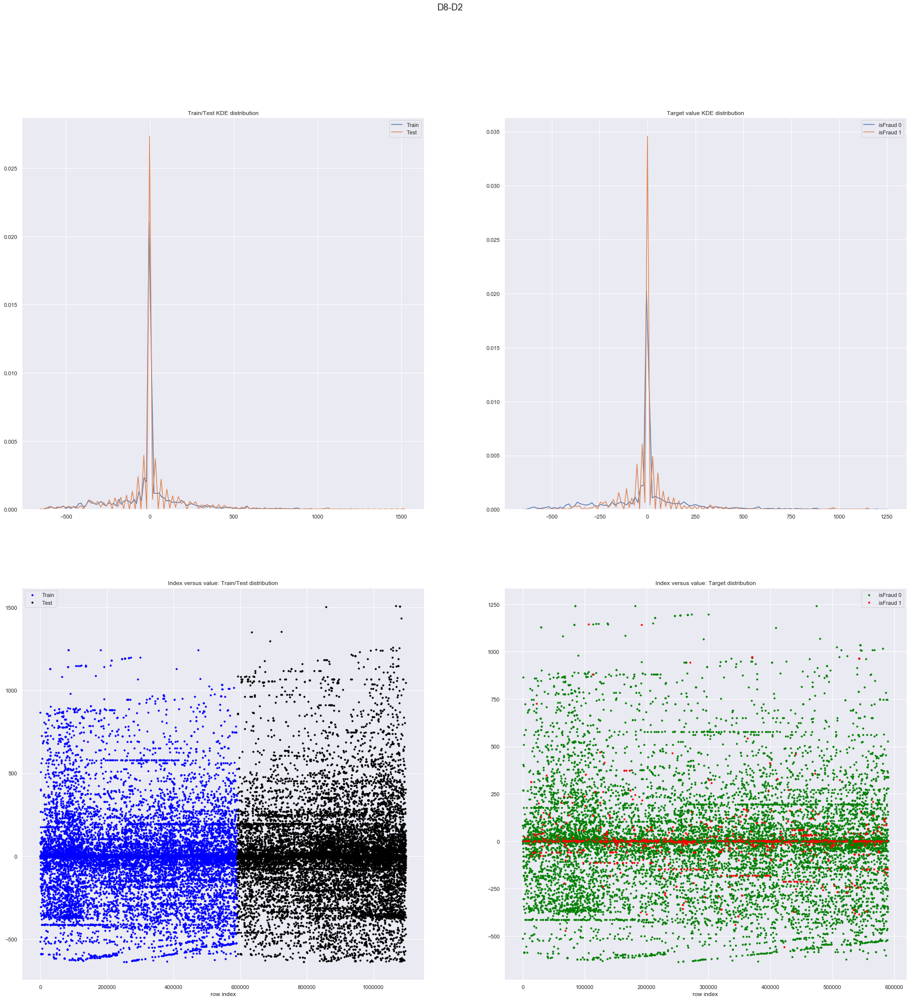

In [33]:
col1,col2 = 'D8','D2'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

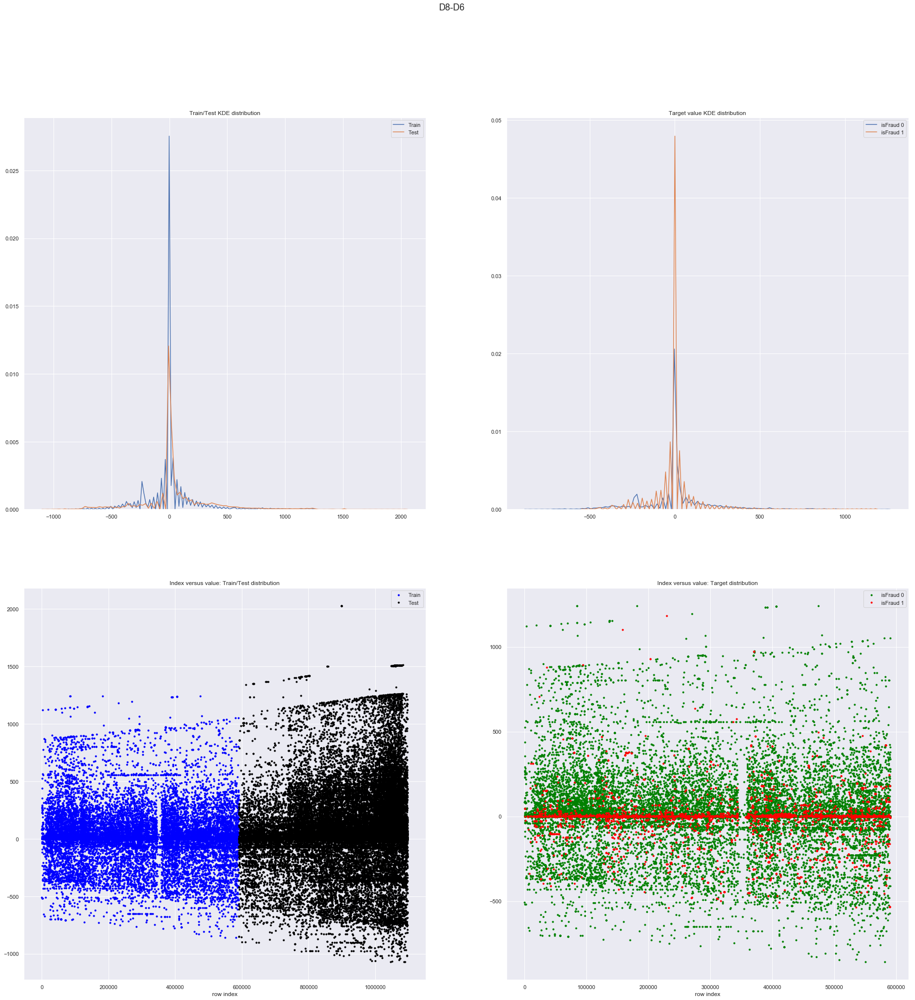

In [34]:
col1,col2 = 'D8','D6'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

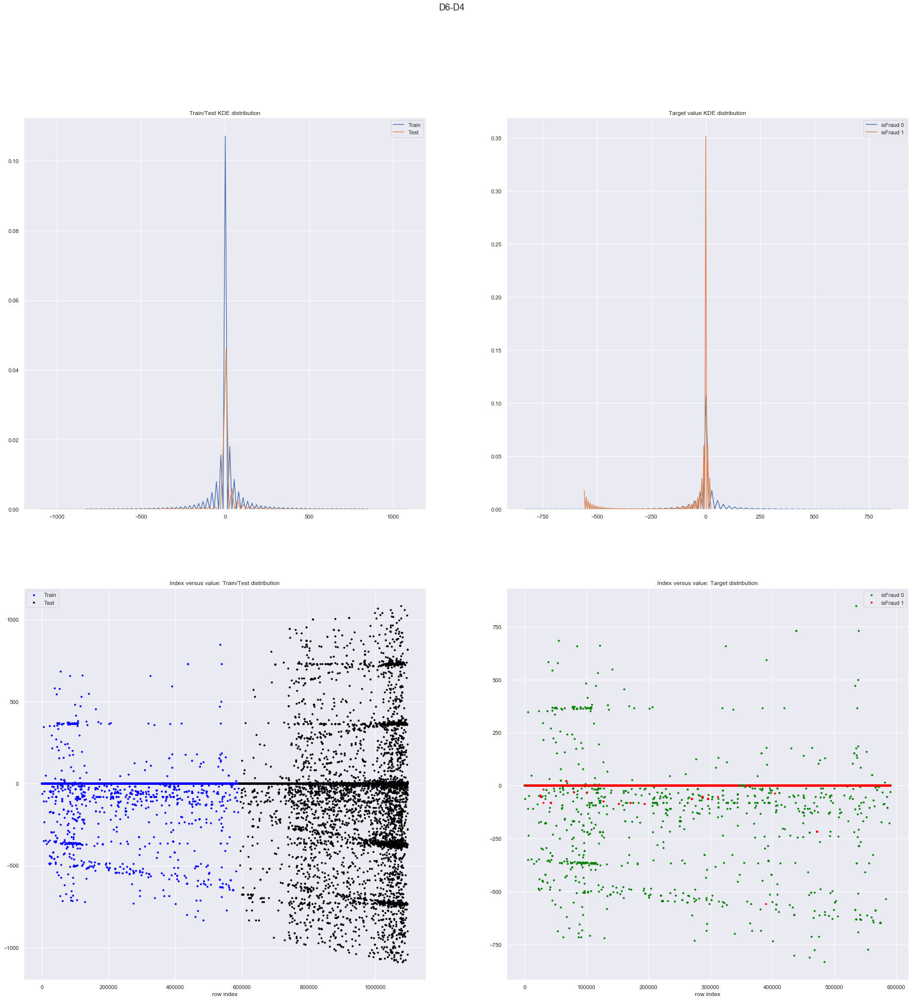

In [35]:
col1,col2 = 'D6','D4'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

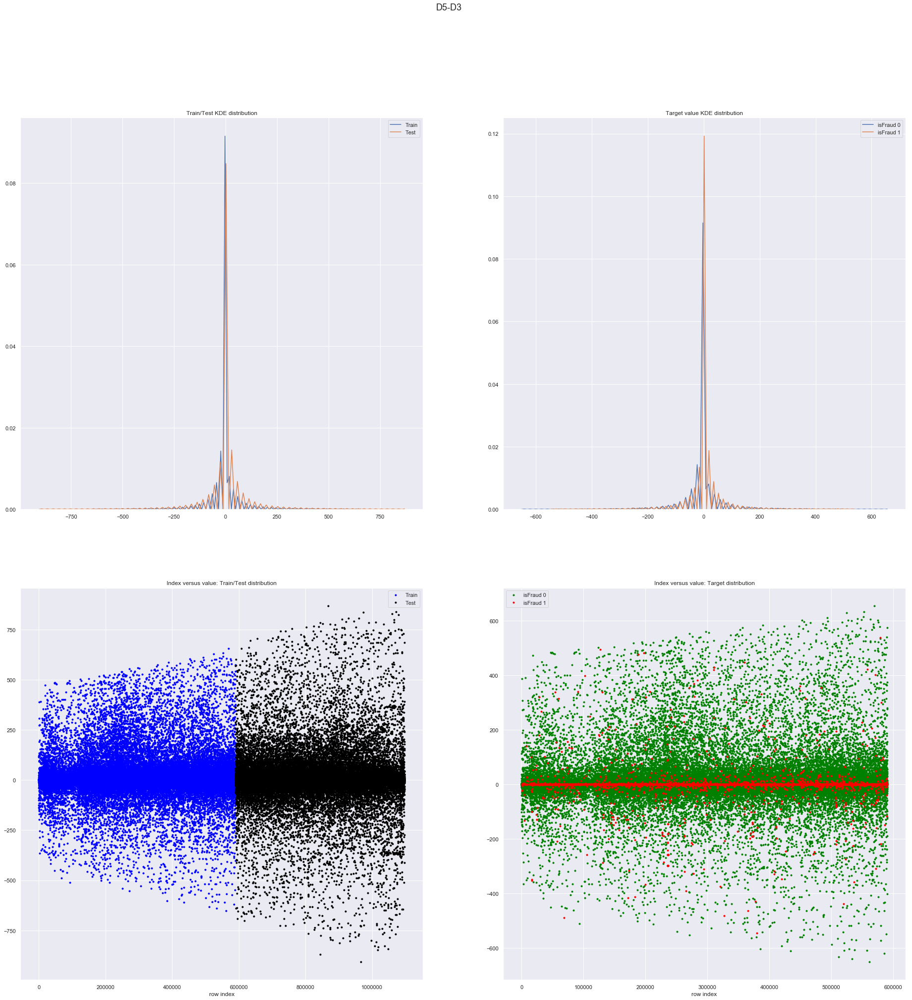

In [36]:
col1,col2 = 'D5','D3' #!!!!!!!!!!!!!!!
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

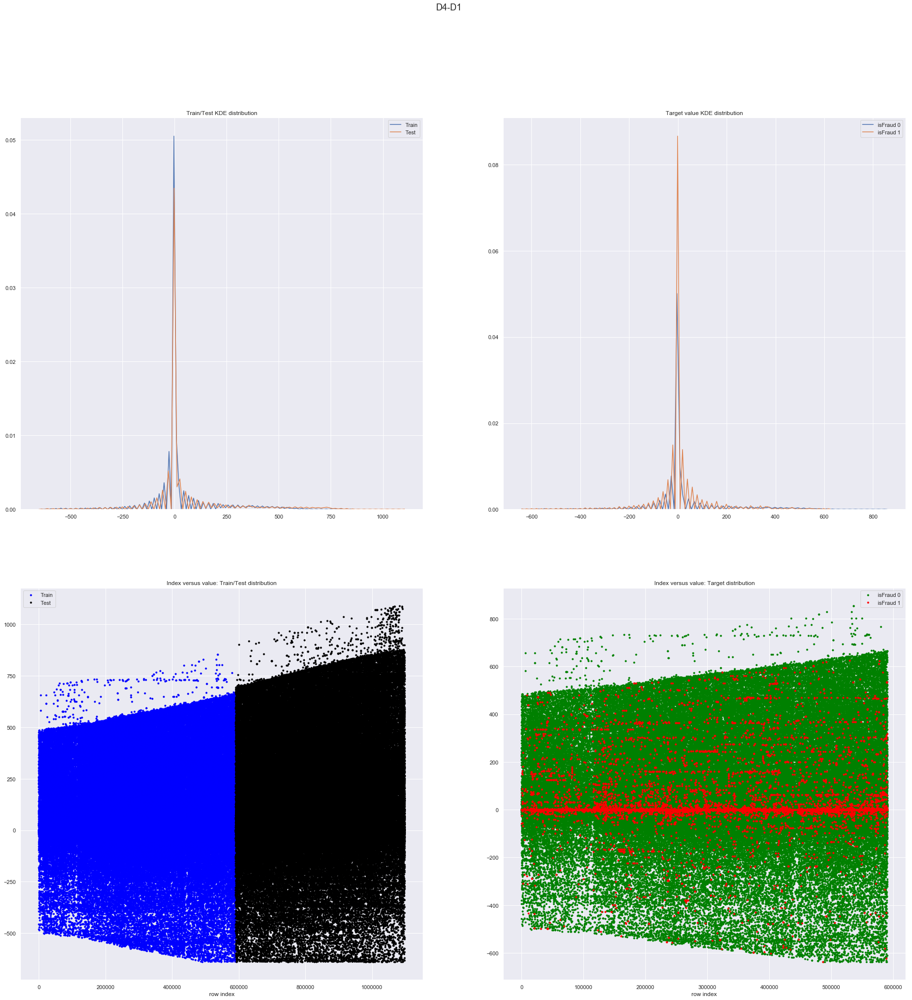

In [37]:
col1,col2 = 'D4','D1'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

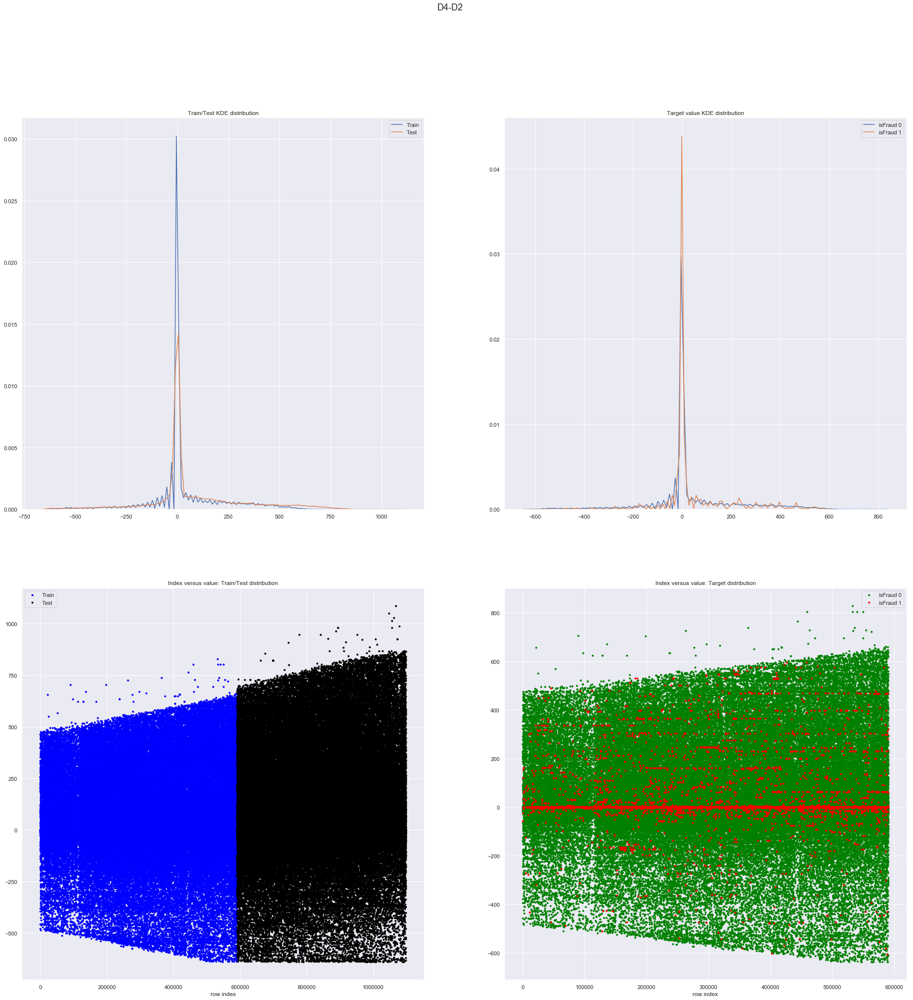

In [38]:
col1,col2 = 'D4','D2'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

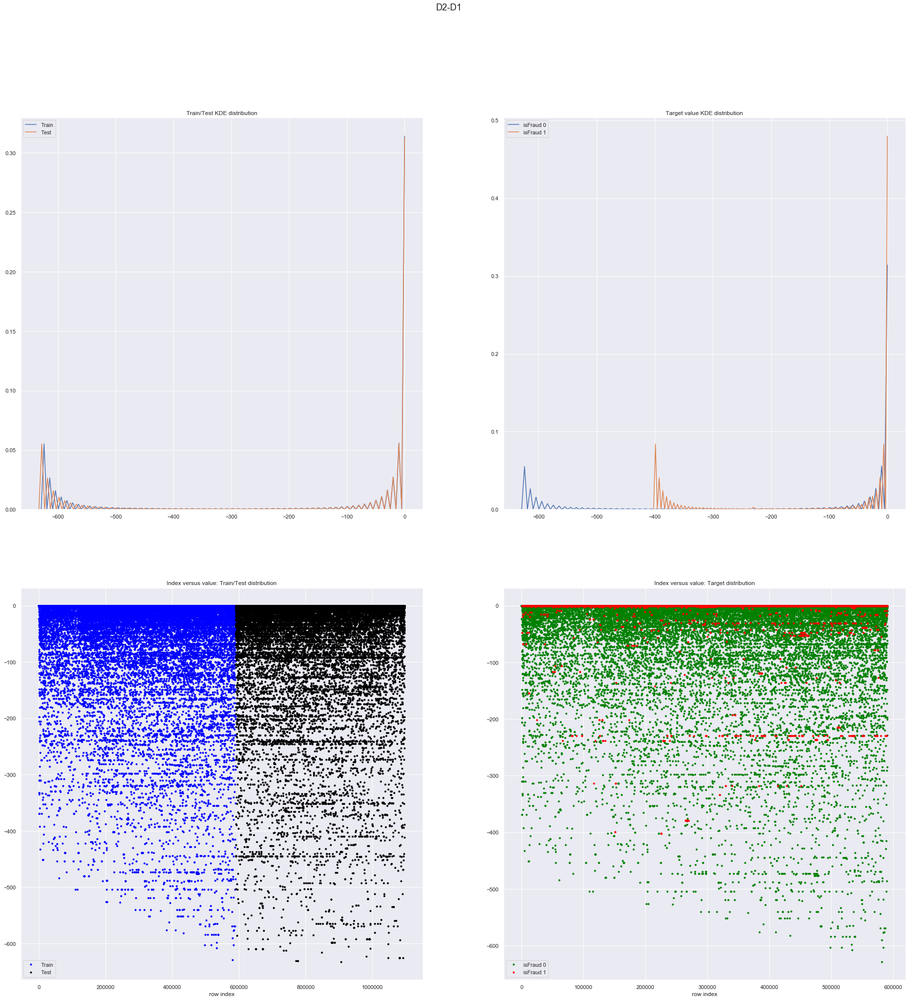

In [39]:
col1,col2 = 'D2','D1'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

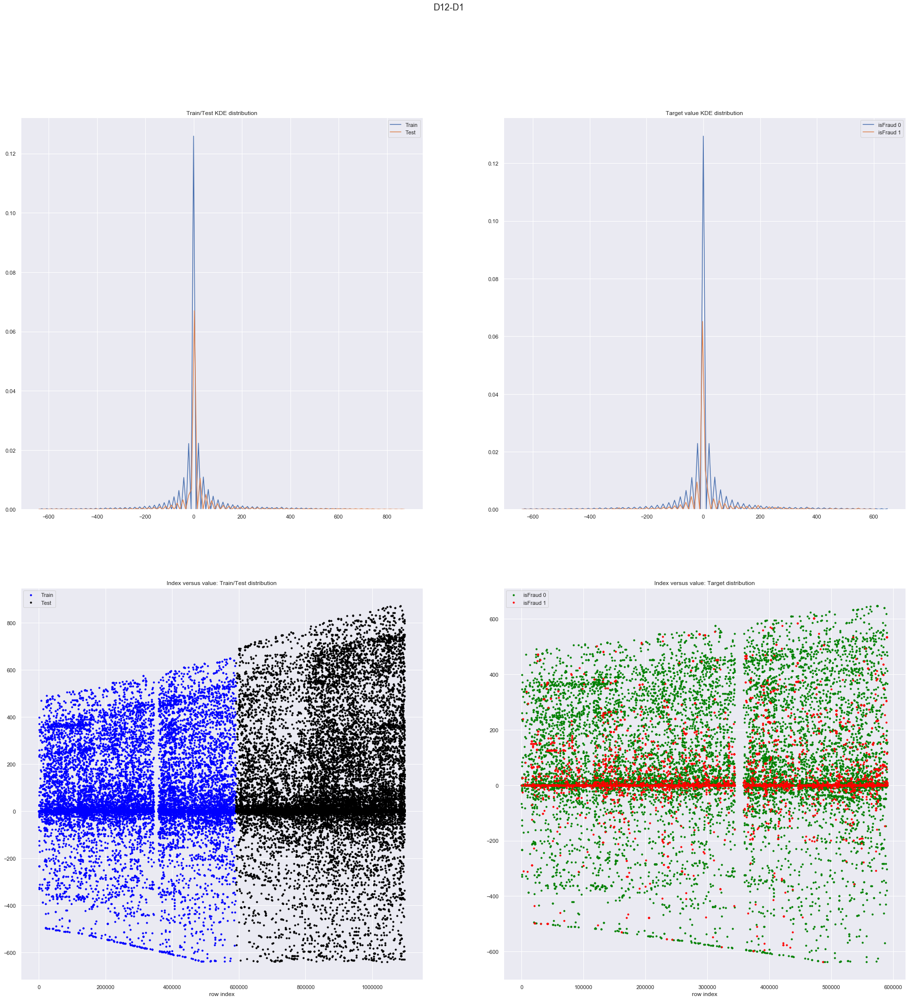

In [47]:
col1,col2 = 'D12','D1'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

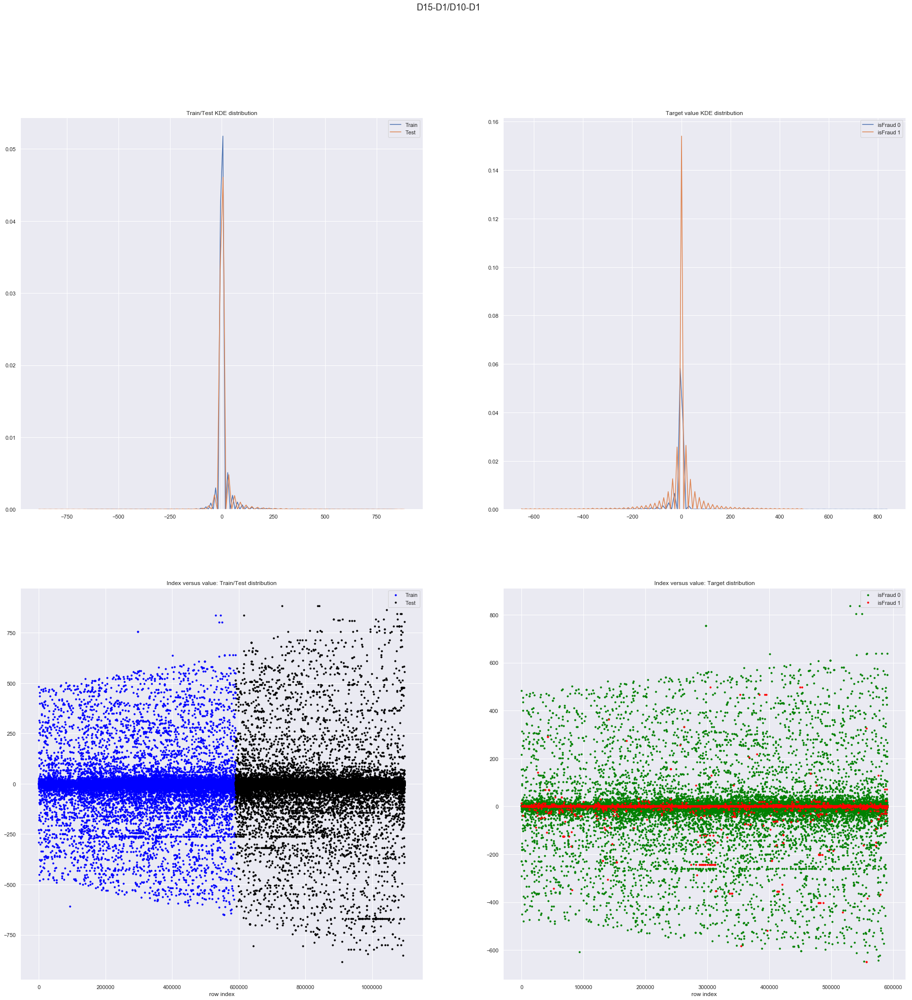

In [42]:
col1,col2 = 'D15-D1','D10-D1'
train['{}/{}'.format(col1,col2)] = train[col1]/train[col2]
test['{}/{}'.format(col1,col2)] = test[col1]/test[col2]
plot_index_vs_value('{}/{}'.format(col1,col2))

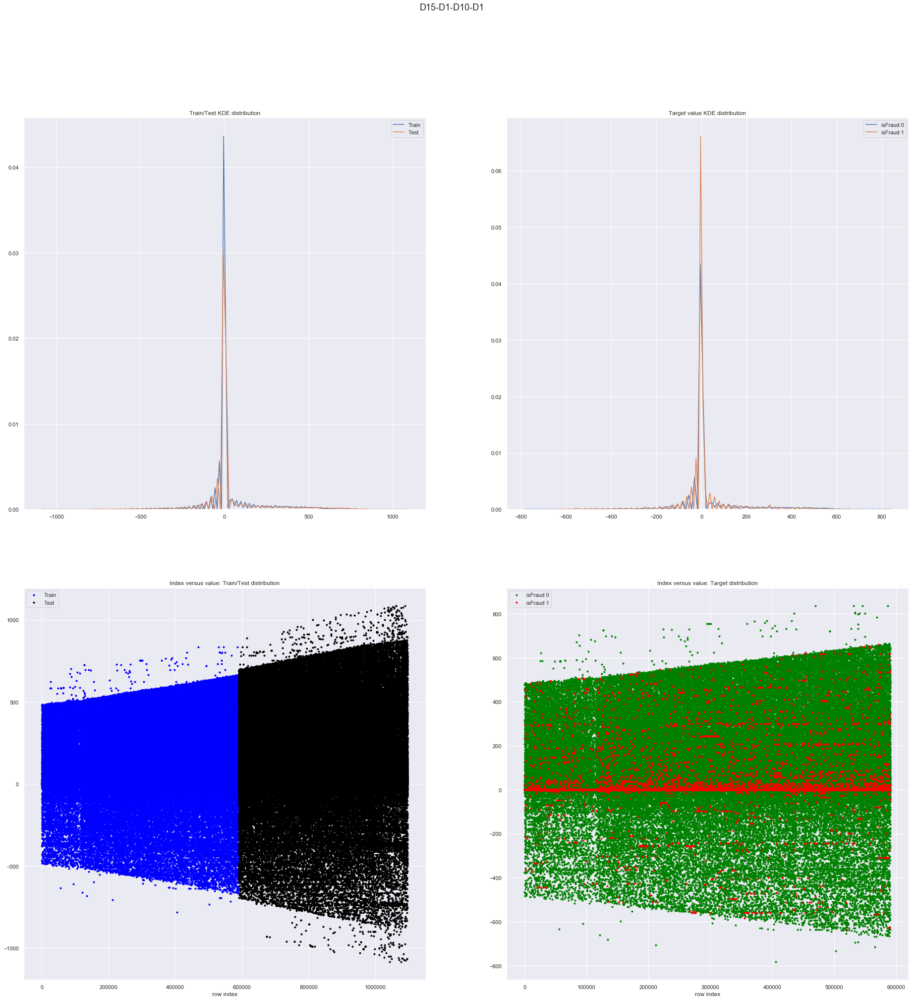

In [51]:
col1,col2 = 'D15-D1','D10-D1'
train['{}-{}'.format(col1,col2)] = train[col1]-train[col2]
test['{}-{}'.format(col1,col2)] = test[col1]-test[col2]
plot_index_vs_value('{}-{}'.format(col1,col2))

In [50]:
train[(train['D12'].notnull()) & (train['D12'] != train['D4']) ][['D4','D12','isFraud']]

,D4,D12,isFraud
964,NaN,233.0,0
8715,NaN,0.0,1
13134,NaN,106.0,1
13167,NaN,106.0,1
13183,NaN,383.0,0
13184,NaN,383.0,0
13185,NaN,383.0,0
13188,NaN,383.0,0
13189,NaN,383.0,0
13191,NaN,383.0,0
